Image is made up from the combination of pixels

Image have height, width and channel 
In RGB= 3 color channel 
IN grayscale= 1 color channel

black = 0 and white =255

# Task

Predict patient have malaria or not. It is binary classification problem 

# Data

In [2]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

In [3]:
dataset, dataset_info=tfds.load('malaria', with_info=True, as_supervised=True, shuffle_files=True,split=['train'])

In [3]:
dataset_info

tfds.core.DatasetInfo(
    name='malaria',
    full_name='malaria/1.0.0',
    description="""
    The Malaria dataset contains a total of 27,558 cell images with equal instances
    of parasitized and uninfected cells from the thin blood smear slide images of
    segmented cells.
    """,
    homepage='https://lhncbc.nlm.nih.gov/publication/pub9932',
    data_dir='C:\\Users\\avith\\tensorflow_datasets\\malaria\\1.0.0',
    file_format=tfrecord,
    download_size=Unknown size,
    dataset_size=317.62 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=27558, num_shards=4>,
    },
    citation="""@article{rajaraman2018pre,
      title={Pre-trained convolutional neural networks as feature extractors toward
      improved malaria parasite detection in thi

In [4]:
dataset

[<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>]

In [5]:
# take one image
for data in dataset[0].take(1):
    print(data)


(<tf.Tensor: shape=(145, 148, 3), dtype=uint8, numpy=
array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)>, <tf.Tensor: shape=(), dtype=int64, numpy=1>)


In [6]:
dataset_eg = tf.data.Dataset.range(10)
dataset_eg = dataset_eg.take(7) # take first 7 value 
print(list(dataset_eg.as_numpy_iterator()))

[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6)]


In [7]:
dataset_eg = tf.data.Dataset.range(10)
dataset_eg = dataset_eg.skip(7) # skip first 7 value and take rest 
print(list(dataset_eg.as_numpy_iterator()))

[np.int64(7), np.int64(8), np.int64(9)]


In [ ]:
TRAIN_RATIO = 0.6
VAL_RATIO = 0.2
TEST_RATIO = 0.2

dataset = tf.data.Dataset.range(10)
print(list(dataset.as_numpy_iterator()))
DATASET_SIZE=len(dataset)

train_dataset = dataset.take(int(TRAIN_RATIO*DATASET_SIZE))
print(list(train_dataset.as_numpy_iterator()))

val_test_dataset = dataset.skip(int(TRAIN_RATIO*DATASET_SIZE))
val_dataset = val_test_dataset.take((int(VAL_RATIO*DATASET_SIZE)))
print(list(val_dataset.as_numpy_iterator()))


test_dataset = val_test_dataset.skip((int(TEST_RATIO*DATASET_SIZE)))
print(list(test_dataset.as_numpy_iterator()))


[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9)]
[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5)]
[np.int64(6), np.int64(7)]
[np.int64(8), np.int64(9)]


In [4]:
TRAIN_RATIO = 0.8
VAL_RATIO = 0.1
TEST_RATIO = 0.1

# func to split the data
def splits(dataset,TRAIN_RATIO,VAL_RATIO,TEST_RATIO):
    DATASET_SIZE=len(dataset)

    train_dataset = dataset.take(int(TRAIN_RATIO*DATASET_SIZE))
    val_test_dataset = dataset.skip(int(TRAIN_RATIO*DATASET_SIZE))
    val_dataset = val_test_dataset.take((int(VAL_RATIO*DATASET_SIZE)))
    test_dataset = val_test_dataset.skip((int(TEST_RATIO*DATASET_SIZE)))
    return train_dataset, val_dataset, test_dataset

In [9]:
dataset = tf.data.Dataset.range(10)
train_dataset, val_dataset, test_dataset = splits(dataset, TRAIN_RATIO,VAL_RATIO, TEST_RATIO)
print(list(train_dataset.as_numpy_iterator()))
print(list(val_dataset.as_numpy_iterator()))
print(list(test_dataset.as_numpy_iterator()))



[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7)]
[np.int64(8)]
[np.int64(9)]


In [11]:
dataset, dataset_info=tfds.load('malaria', with_info=True, as_supervised=True, shuffle_files=True,split=['train'])

In [5]:
# dataset is made up of dataset and type
# we need to take only dataset to  dataset[0]
train_dataset, val_dataset, test_dataset = splits(dataset[0], TRAIN_RATIO,VAL_RATIO, TEST_RATIO)
print(list(train_dataset.as_numpy_iterator()))
print(list(val_dataset.as_numpy_iterator()))
print(list(test_dataset.as_numpy_iterator()))

[(array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), np.int64(0)), (array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 

In [ ]:
dataset

[<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>]

# Data Visualization

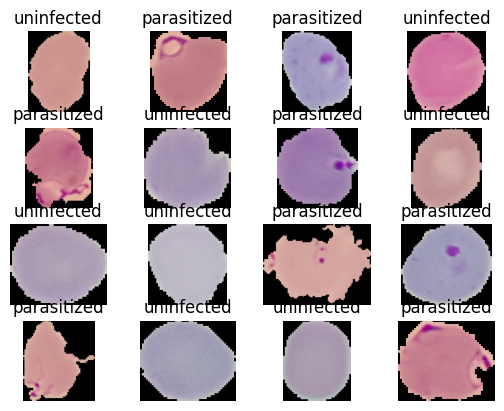

In [13]:
for i, (image, label) in enumerate(train_dataset.take(16)):
    ax=plt.subplot(4,4,i+1)
    plt.imshow(image)
    plt.title(dataset_info.features['label'].int2str(label))
    plt.axis('off')
    

# Data Preprocessing

Images where most of its pixels revolve around a particular mean value then use standardize.

If image is made of pixels where their values are most different from one another, then use normalize. For DL normalization[0-1 or -1 to 1] it best.
Reasons:
- Most deep learning models use ReLU or sigmoid activation functions, which work better with values in a small range (e.g., [0,1] or [-1,1]).
- Avoids large values that can cause vanishing or exploding gradients.
- Reduces computational complexity and speeds up training.

In image, X = (X- Xmin)/(Xmax-Xmin) = X-0/255-0 = X/255


In [9]:
IM_SIZE = 224
# processing on image only
# resize we are making image 244*244
#rescale by normalization
def resizing_rescaling(image, label):
    return tf.image.resize(image, (IM_SIZE, IM_SIZE))/255.0, label

In [6]:
train_dataset = train_dataset.map(resizing_rescaling)

In [20]:
val_dataset= val_dataset.map(resizing_rescaling)
test_dataset=test_dataset.map(resizing_rescaling)

In [11]:
for image, label in train_dataset.take(1):
    print(image,label)

tf.Tensor(
[[[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 ...

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]], shape=(224, 224, 3), dtype=float32) tf.Tensor(0, shape=(), dtype=int64)


In [21]:
train_dataset = train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [13]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [22]:
val_dataset = val_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [15]:
val_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

# ConvNets

In regular fully connected layer each the neuron is connected to all of previous. This increase the total number of parameters considerably.

Now, we need to create NN layer where each neuron is not all connected to all previous neurons. This is Convolution layer

Kernal(filter) reduce the size.

Reduce the kernal size permits us extract more features from the inputs

Weight(W) anf Height(H): to find the size of ouput 
Wout = Win - kernal_size +1
Hout = Hin - kernal_size +1

We want to have particular feature map shape which is not possible just using kernal size then we use padding. We have also another advantage of padding that coner pixel also have an influence on our output features which are generated.

We have stride. This is step you are going to move next.

Now new formula is 

Wo = ((Wi - kernal_size + 2 Padding)/Stride) +1

Pooling layer = filter size and number of strides

Xout = ((Xin - F)/S)+1

max pooling= we pick the max value of them
avg pooling = we pick the avg value of them

After con and pooling, we flaten the ouput and then we do fully connected layers

In [23]:
from tensorflow.keras.layers import Conv2D, MaxPool2D, Dense, Flatten, InputLayer
from tensorflow.keras.layers import BatchNormalization

In [18]:
model = tf.keras.Sequential([
    InputLayer(shape=(IM_SIZE,IM_SIZE,3)),
    Conv2D(filters=6,kernel_size=3,strides=1,padding="valid",activation = "relu"), 
    BatchNormalization(),
    MaxPool2D(pool_size=2, strides=2),
    Conv2D(filters=16,kernel_size=3,strides=1,padding="valid",activation = "relu"), 
    BatchNormalization(),
    MaxPool2D(pool_size=2, strides=2),
    Flatten(),
    Dense(100, activation= 'relu'),
    BatchNormalization(),
    Dense(10, activation= 'relu'),
    BatchNormalization(),
    Dense(1, activation= 'sigmoid'),
])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 6)    │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 6)    │            24 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 16)   │           880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 109, 109, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 46656)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │     4,665,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 10)             │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,668,297 (17.81 MB)

 Trainable params: 4,668,033 (17.81 MB)

 Non-trainable params: 264 (1.03 KB)

# Binary Crossentropy Loss

For error sanctioning binary classification problem we generally use Binary Cross entropy loss

-((ylog(p))+(1-y)log(1-p))

We penalized the model if it is prediction value(p) is different from the actual value(y).

Our model now makes use of binary corss entropy loss to update its weights

In [19]:
y_true=[0]
y_pred=[0.8]

bce=tf.keras.losses.BinaryCrossentropy()
bce(y_true,y_pred)

<tf.Tensor: shape=(), dtype=float32, numpy=1.6094379425048828>

In [20]:
y_true=[0]
y_pred=[0]

bce=tf.keras.losses.BinaryCrossentropy()
bce(y_true,y_pred)

<tf.Tensor: shape=(), dtype=float32, numpy=1.1920930376163597e-07>

In [21]:
y_true=[1]
y_pred=[1]

bce=tf.keras.losses.BinaryCrossentropy()
bce(y_true,y_pred)

<tf.Tensor: shape=(), dtype=float32, numpy=1.1920930376163597e-07>

if your value range between zero and one make sure you use default from_logits = False


In [24]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanAbsoluteError, BinaryCrossentropy
from tensorflow.keras.metrics import RootMeanSquaredError

In [ ]:

model.compile(optimizer=Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics = ['accuracy']
)

# Training Convnets

In [23]:
history=model.fit(train_dataset, validation_data=val_dataset, epochs=10, verbose=1)

Epoch 1/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 168s 238ms/step - accuracy: 0.6525 - loss: 0.6216 - val_accuracy: 0.9049 - val_loss: 0.3429
Epoch 2/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 167s 242ms/step - accuracy: 0.8891 - loss: 0.3087 - val_accuracy: 0.8708 - val_loss: 0.5441
Epoch 3/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 172s 249ms/step - accuracy: 0.9193 - loss: 0.2483 - val_accuracy: 0.5205 - val_loss: 14.7578
Epoch 4/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 157s 227ms/step - accuracy: 0.9127 - loss: 0.2666 - val_accuracy: 0.4951 - val_loss: 2.4962
Epoch 5/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 155s 224ms/step - accuracy: 0.9162 - loss: 0.2658 - val_accuracy: 0.4926 - val_loss: 5.2762
Epoch 6/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 153s 222ms/step - accuracy: 0.8704 - loss: 0.3287 - val_accuracy: 0.4904 - val_loss: 0.8479
Epoch 7/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 154s 224ms/step - accuracy: 0.9305 - loss: 0.2242 - val_accuracy: 0.7289 - val_loss: 2.1190
Epoch 8/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 161s 233ms/step - accuracy: 0.9218 

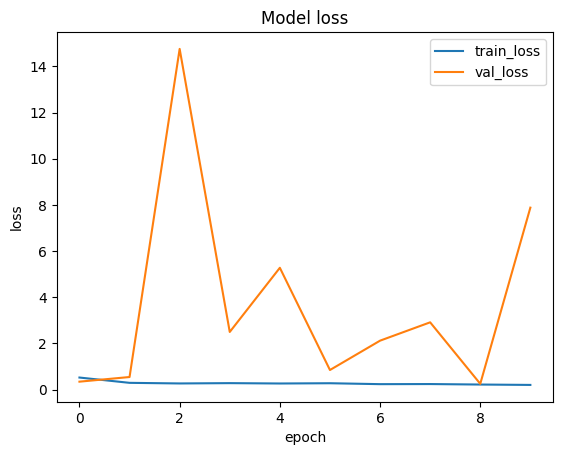

In [24]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train_loss', 'val_loss'])
plt.show()

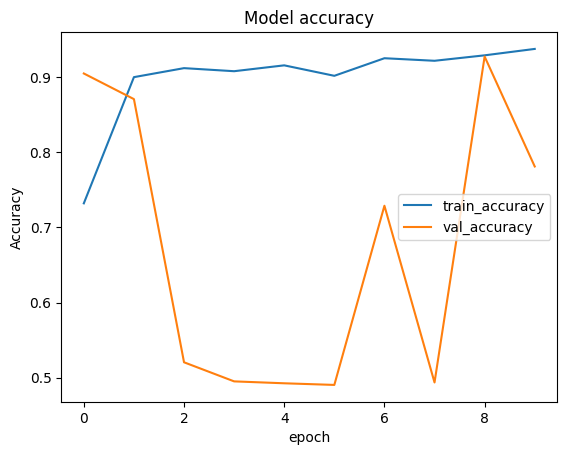

In [25]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('epoch')
plt.legend(['train_accuracy', 'val_accuracy'])
plt.show()

# Validating and Testing 

In [26]:
test_dataset

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [27]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [14]:
test_dataset=test_dataset.batch(1)

In [15]:
test_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [30]:
model.evaluate(test_dataset)

2757/2757 ━━━━━━━━━━━━━━━━━━━━ 14s 4ms/step - accuracy: 0.8016 - loss: 2.5744


[2.574439287185669, 0.7936162352561951]

In [31]:
model.predict(test_dataset.take(1))[0][0]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


np.float32(1.0)

In [32]:
def para_or_not(x):
    if (x<0.5): return str("P")
    else: return str("N")

In [33]:
para_or_not(model.predict(test_dataset.take(1))[0][0])

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


'P'

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


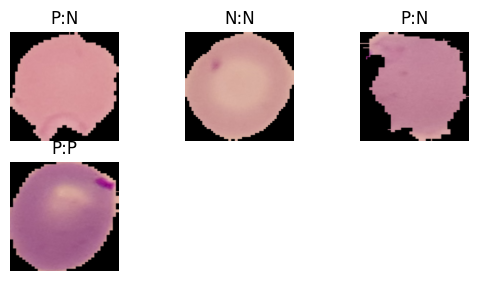

In [34]:
for i, (image, label) in enumerate(test_dataset.take(4)):
    ax=plt.subplot(3,3,i+1)
    plt.imshow(image[0])
    plt.title(str(para_or_not(label.numpy()[0])) + ":" + str(para_or_not(model.predict(image)[0][0])))
    plt.axis('off')
    
    

# Loading and Saving Model

In [ ]:
# Save the model for the next session
# dataset need to be in tensor
model.save("saved_model/malaria_model.keras")
print("Model saved successfully!")

Model saved successfully!


In [39]:
# Load or create a model
try:
    model = tf.keras.models.load_model("saved_model/malaria_model.keras")  # Load if exists
    print("Model loaded successfully!")
except:
    model = create_model()  # Define your model function
    print("New model created!")

# Train for 10 epochs
history=model.fit(train_dataset, validation_data=val_dataset, epochs=10, verbose=1)

# Save the model for the next session
model.save("saved_model/malaria_model.keras")
print("Model saved successfully!")

Model loaded successfully!
Epoch 1/10


c:\Users\avith\anaconda3\envs\cv_dl\lib\site-packages\keras\src\saving\saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 38 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


689/689 ━━━━━━━━━━━━━━━━━━━━ 168s 240ms/step - accuracy: 0.9399 - loss: 0.1996 - val_accuracy: 0.9350 - val_loss: 0.2007
Epoch 2/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 153s 222ms/step - accuracy: 0.9497 - loss: 0.1691 - val_accuracy: 0.9423 - val_loss: 0.2032
Epoch 3/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 155s 225ms/step - accuracy: 0.9562 - loss: 0.1525 - val_accuracy: 0.9238 - val_loss: 0.3075
Epoch 4/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 158s 229ms/step - accuracy: 0.9586 - loss: 0.1399 - val_accuracy: 0.9405 - val_loss: 0.2027
Epoch 5/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 160s 233ms/step - accuracy: 0.9590 - loss: 0.1386 - val_accuracy: 0.4936 - val_loss: 4.6598
Epoch 6/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 161s 234ms/step - accuracy: 0.9292 - loss: 0.2112 - val_accuracy: 0.9459 - val_loss: 0.3015
Epoch 7/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 161s 233ms/step - accuracy: 0.9589 - loss: 0.1397 - val_accuracy: 0.8987 - val_loss: 0.3071
Epoch 8/10
689/689 ━━━━━━━━━━━━━━━━━━━━ 167s 242ms/step - accuracy: 0.9609 - loss: 0.13

# Loading and Saving Models to Google Drive

In [ ]:
drive.mount('/content/drive')

In [ ]:
!cp -r /content/lenet/ /content/drive/MyDrive/model_colab/

In [ ]:
!cp -r /content/drive/Mydrive/model_colab/ /content/model_colab/

# Functional API

- Can handle models with non-linear topology
- Mutiple output is only possible 
- Create more complex models
- Can be use shared layer.

 Input 1 ───┐  
            │  
 Input 2 ───┼──→[Shared Layer]→Encoded Outputs→[Concatenation]→[Dense Layer]→Final Output  
            │  
 Input 3 ───┘  


In [18]:
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model

Conv Layer are responsible for extracting useful features from images. 
Other layer (FC) after flatten are responsible for correctly classifying whether the image is parasitic or not.

In [19]:
func_input = Input(shape=(IM_SIZE, IM_SIZE,3), name="input")
x= Conv2D(filters=6,kernel_size=3,strides=1,padding="valid",activation = "relu")(func_input) 
x=BatchNormalization()(x)
x=MaxPool2D(pool_size=2, strides=2)(x)
x=Conv2D(filters=16,kernel_size=3,strides=1,padding="valid",activation = "relu")(x) 
x=BatchNormalization()(x)
x=MaxPool2D(pool_size=2, strides=2)(x)
x=Flatten()(x)
x=Dense(100, activation= 'relu')(x)
x=BatchNormalization()(x)
x=Dense(10, activation= 'relu')(x)
x=BatchNormalization()(x)
func_output=Dense(1, activation= 'sigmoid')(x)
model=Model(func_input, func_output,name="Lenet_model")
model.summary()

Model: "Lenet_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 222, 222, 6)    │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 6)    │            24 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 16)   │           880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 109, 109, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 46656)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │     4,665,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 10)             │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,668,297 (17.81 MB)

 Trainable params: 4,668,033 (17.81 MB)

 Non-trainable params: 264 (1.03 KB)

In [20]:
# feature extractor
func_input = Input(shape=(IM_SIZE, IM_SIZE,3), name="input")
x= Conv2D(filters=6,kernel_size=3,strides=1,padding="valid",activation = "relu")(func_input) 
x=BatchNormalization()(x)
x=MaxPool2D(pool_size=2, strides=2)(x)
x=Conv2D(filters=16,kernel_size=3,strides=1,padding="valid",activation = "relu")(x) 
x=BatchNormalization()(x)
output=MaxPool2D(pool_size=2, strides=2)(x)

feature_extractor_model=Model(func_input, output,name="feature_extractor")
feature_extractor_model.summary()

Model: "feature_extractor"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 222, 222, 6)    │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 222, 222, 6)    │            24 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 111, 111, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 109, 109, 16)   │           880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 109, 109, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 54, 54, 16)     │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,136 (4.44 KB)

 Trainable params: 1,092 (4.27 KB)

 Non-trainable params: 44 (176.00 B)

In [21]:
func_input=Input(shape=(IM_SIZE,IM_SIZE,3), name="input")
# model is callable like function
x=feature_extractor_model(func_input)
x=Flatten()(x)
x=Dense(100, activation= 'relu')(x)
x=BatchNormalization()(x)
x=Dense(10, activation= 'relu')(x)
x=BatchNormalization()(x)
func_output=Dense(1, activation= 'sigmoid')(x)
model=Model(func_input, func_output,name="Lenet_model")
model.summary()

Model: "Lenet_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ feature_extractor (Functional)  │ (None, 54, 54, 16)     │         1,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 46656)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 100)            │     4,665,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 10)             │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 10)             │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,668,297 (17.81 MB)

 Trainable params: 4,668,033 (17.81 MB)

 Non-trainable params: 264 (1.03 KB)

In [22]:
model.compile(optimizer=Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics = ['accuracy']
)

history=model.fit(train_dataset, validation_data=val_dataset, epochs=5, verbose=1)

Epoch 1/5


689/689 ━━━━━━━━━━━━━━━━━━━━ 187s 265ms/step - accuracy: 0.6880 - loss: 0.5729 - val_accuracy: 0.8788 - val_loss: 0.6729
Epoch 2/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 170s 246ms/step - accuracy: 0.9224 - loss: 0.2501 - val_accuracy: 0.9470 - val_loss: 0.2919
Epoch 3/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 174s 253ms/step - accuracy: 0.9359 - loss: 0.2085 - val_accuracy: 0.9122 - val_loss: 0.2552
Epoch 4/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 186s 269ms/step - accuracy: 0.9366 - loss: 0.2033 - val_accuracy: 0.9158 - val_loss: 0.2197
Epoch 5/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 187s 271ms/step - accuracy: 0.9387 - loss: 0.1975 - val_accuracy: 0.9488 - val_loss: 0.1998


# Model Subclassing

Model Subclassing permits us to create recursively composable layers and models. This means I could create a layer where its attributes are other layers and this layer tracks the weights and biases of the sub layers.

Model subclassing is needed when predefined Keras APIs (Sequential & Functional) are too restrictive for your use case. It allows you to build dynamic, complex models with full control over their behavior.


In [23]:
from tensorflow.keras.layers import Layer

In [24]:
class FeatureExtractor(Layer):
  def __init__(self, filters, kernel_size, strides, padding, activation, pool_size,):
    super(FeatureExtractor, self).__init__()

    self.conv_1 = Conv2D(filters = filters, kernel_size = kernel_size, strides = strides, padding = padding, activation = activation)
    self.batch_1 = BatchNormalization()
    self.pool_1 = MaxPool2D (pool_size = pool_size, strides= 2*strides)

    self.conv_2 = Conv2D(filters = filters*2, kernel_size = kernel_size, strides = strides, padding = padding, activation = activation)
    self.batch_2 = BatchNormalization()
    self.pool_2 = MaxPool2D (pool_size = pool_size, strides= 2*strides)

  def call(self, x,):# training tell whether to use a given layer or not during training process

    x = self.conv_1(x)
    x = self.batch_1(x)
    x = self.pool_1(x)

    x = self.conv_2(x)
    x = self.batch_2(x)
    x = self.pool_2(x)

    return x
        
feature_sub_classed = FeatureExtractor(8,3,1,"valid", "relu", 2)


In [25]:
func_input=Input(shape=(IM_SIZE,IM_SIZE,3), name="input")
# model is callable like function
x=feature_sub_classed(func_input)
x=Flatten()(x)
x=Dense(100, activation= 'relu')(x)
x=BatchNormalization()(x)
x=Dense(10, activation= 'relu')(x)
x=BatchNormalization()(x)
func_output=Dense(1, activation= 'sigmoid')(x)
model=Model(func_input, func_output,name="Lenet_model")
model.summary()

Model: "Lenet_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ feature_extractor               │ (None, 54, 54, 16)     │         1,488 │
│ (FeatureExtractor)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 46656)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 100)            │     4,665,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 10)             │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 10)             │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,668,649 (17.81 MB)

 Trainable params: 4,668,381 (17.81 MB)

 Non-trainable params: 268 (1.05 KB)

In [26]:
class LenetModel(Model):
  def __init__(self):
    super(LenetModel, self).__init__()

    self.feature_extractor = FeatureExtractor(8, 3, 1, "valid", "relu", 2)
    self.flatten = Flatten()

    self.dense_1 = Dense(100, activation = "relu")
    self.batch_1 = BatchNormalization()

    self.dense_2 = Dense(10, activation = "relu")
    self.batch_2 = BatchNormalization()

    self.dense_3 = Dense(1, activation = "sigmoid")
    
  def call(self, x):

    x = self.feature_extractor(x)
    x = self.flatten(x)
    x = self.dense_1(x)
    x = self.batch_1(x)
    x = self.dense_2(x)
    x = self.batch_2(x)
    x = self.dense_3(x)

    return x
    
lenet_sub_classed = LenetModel()

#performs a forward pass of the LenetModel using a dummy input tensor of shape
#it do not effect 
# It verifies that the input dimensions flow correctly through the layers.

lenet_sub_classed(tf.zeros([1,224,224,3]))

lenet_sub_classed.summary()

Model: "lenet_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ feature_extractor_1             │ ?                      │         1,488 │
│ (FeatureExtractor)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (1, 46656)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (1, 100)               │     4,665,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (1, 100)               │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (1, 10)                │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (1, 10)                │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (1, 1)                 │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,668,649 (17.81 MB)

 Trainable params: 4,668,381 (17.81 MB)

 Non-trainable params: 268 (1.05 KB)

In [27]:
model.compile(optimizer=Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics = ['accuracy']
)

history=model.fit(train_dataset, validation_data=val_dataset, epochs=5, verbose=1)

Epoch 1/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 181s 256ms/step - accuracy: 0.6319 - loss: 0.6445 - val_accuracy: 0.5074 - val_loss: 4.7282
Epoch 2/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 177s 257ms/step - accuracy: 0.9088 - loss: 0.2758 - val_accuracy: 0.8995 - val_loss: 0.3652
Epoch 3/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 177s 257ms/step - accuracy: 0.9331 - loss: 0.2255 - val_accuracy: 0.9278 - val_loss: 0.3095
Epoch 4/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 178s 259ms/step - accuracy: 0.9325 - loss: 0.2286 - val_accuracy: 0.8770 - val_loss: 0.5079
Epoch 5/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 184s 266ms/step - accuracy: 0.9313 - loss: 0.2221 - val_accuracy: 0.8806 - val_loss: 0.3918


# Custom Layers

In [28]:
class CustomDense(Layer):
    def __init__(self, output_units, activation):
        super(CustomDense, self).__init__()
        self.output_units = output_units
        self.activation = activation
  
    def build(self, input_features_shape):
        self.w = self.add_weight(shape = (input_features_shape[-1], self.output_units), initializer = "random_normal", trainable = True)
        self.b = self.add_weight(shape = (self.output_units,), initializer = "random_normal", trainable = True)
  
    def call(self, input_features):

        pre_output = tf.matmul(input_features, self.w) + self.b

        if(self.activation == "relu"):
            return tf.nn.relu(pre_output)

        elif(self.activation == "sigmoid"):
            return tf.math.sigmoid(pre_output)

        else:
            return pre_output

In [29]:
IM_SIZE = 224
lenet_custom_model = tf.keras.Sequential([
                             InputLayer(input_shape = (IM_SIZE, IM_SIZE, 3)),

                             Conv2D(filters = 6, kernel_size = 3, strides=1, padding='valid', activation = 'relu'),
                             BatchNormalization(),
                             MaxPool2D (pool_size = 2, strides= 2),

                             Conv2D(filters = 16, kernel_size = 3, strides=1, padding='valid', activation = 'relu'),
                             BatchNormalization(),
                             MaxPool2D (pool_size = 2, strides= 2),

                             Flatten(),
                             
                             CustomDense(100, activation = "relu"),
                             BatchNormalization(),
                             
                             CustomDense(10, activation = "relu"),
                             BatchNormalization(),

                            CustomDense(1, activation = "sigmoid"),

])
lenet_custom_model.summary()

c:\Users\avith\anaconda3\envs\cv_dl\lib\site-packages\keras\src\layers\core\input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 222, 222, 6)    │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 222, 222, 6)    │            24 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 111, 111, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 109, 109, 16)   │           880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 109, 109, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 54, 54, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 46656)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ custom_dense (CustomDense)      │ (None, 100)            │     4,665,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ custom_dense_1 (CustomDense)    │ (None, 10)             │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 10)             │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ custom_dense_2 (CustomDense)    │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,668,297 (17.81 MB)

 Trainable params: 4,668,033 (17.81 MB)

 Non-trainable params: 264 (1.03 KB)

# Precision, Recall and Accuracy

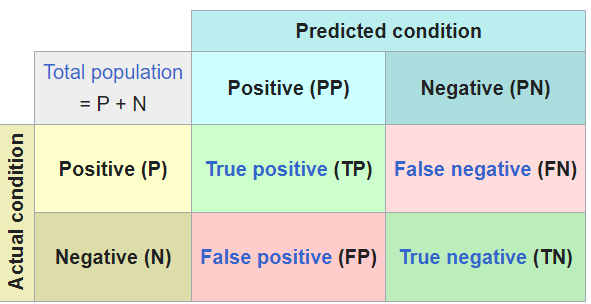

Precision = TP/TP+FP

Recall = TP/TP+FN

Accuracy = TN+TP/TN+TP+FN+FP

F1-score = 2PR/P+R

Specificity = TN/TN+FP

A ROC(Receiver Operating Characteristic) curve focuses on finding the errors and benefits classifiers use to organize classes. evaluates a classifier’s ability to distinguish between positive and negative classes by analyzing:
1. TP rate (recall or sensitivity): Measures how well the model identifies actual positives. TP/TP+FN
2. FP rate : Measures how many negatives were incorrectly classified as positive. FP/FP+TN

In ROC curve shows Trade-off between TPR & FPR at different thresholds.

A better ROC curve is one that is:
✅ Closer to the top-left corner → High True Positive Rate (TPR) and low 

False Positive Rate (FPR).
✅ Higher AUC (Area Under Curve) → AUC closer to 1.0 means better classification performance.



In [30]:
from tensorflow.keras.metrics import BinaryAccuracy, FalsePositives, FalseNegatives, TruePositives, TrueNegatives, Precision, Recall, AUC

In [ ]:
metrics=[TruePositives(name='tp'), FalsePositives(name='fp'), TrueNegatives(name='tn'), FalseNegatives(name='fn'), BinaryAccuracy(name='accuracy'), Precision(name='precision'), Recall(name='recall'), AUC(name='auc')]

model.compile(optimizer=Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics = metrics
)

history=model.fit(train_dataset, validation_data=val_dataset, epochs=5, verbose=1)

Epoch 1/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 172s 243ms/step - accuracy: 0.6913 - auc: 0.7563 - fn: 1379.5928 - fp: 1605.9376 - loss: 0.5715 - precision: 0.6848 - recall: 0.7246 - tn: 3912.8145 - tp: 4157.6030 - val_accuracy: 0.9125 - val_auc: 0.9414 - val_fn: 79.0000 - val_fp: 162.0000 - val_loss: 0.3661 - val_precision: 0.8890 - val_recall: 0.9426 - val_tn: 1217.0000 - val_tp: 1297.0000
Epoch 2/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 169s 246ms/step - accuracy: 0.9244 - auc: 0.9496 - fn: 314.9420 - fp: 528.5305 - loss: 0.2514 - precision: 0.9073 - recall: 0.9466 - tn: 4990.3042 - tp: 5222.1709 - val_accuracy: 0.5034 - val_auc: 0.5062 - val_fn: 0.0000e+00 - val_fp: 1368.0000 - val_loss: 7.0309 - val_precision: 0.5029 - val_recall: 1.0000 - val_tn: 3.0000 - val_tp: 1384.0000
Epoch 3/5
689/689 ━━━━━━━━━━━━━━━━━━━━ 153s 222ms/step - accuracy: 0.8990 - auc: 0.9418 - fn: 312.0348 - fp: 708.2739 - loss: 0.2771 - precision: 0.8678 - recall: 0.9446 - tn: 4810.4771 - tp: 5225.1621 - val_accuracy: 0.9328 - va

In [ ]:
test_dataset= test_dataset.batch(1)

In [23]:
model.evaluate(test_dataset)

ValueError: Input 0 of layer "Lenet_model" is incompatible with the layer: expected shape=(None, 224, 224, 3), found shape=(224, 224, 3)

# Confusion Matrix

In [31]:
import sklearn
from sklearn.metrics import confusion_matrix
import seaborn as sns

In [32]:
labels=[]
inputs = []
for x,y in test_dataset.as_numpy_iterator():
    labels.append(y)
    inputs.append(x)

In [ ]:
print(labels)

[array([0]), array([1]), array([0]), array([0]), array([0]), array([1]), array([0]), array([0]), array([1]), array([1]), array([1]), array([0]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([0]), array([1]), array([1]), array([0]), array([1]), array([0]), array([0]), array([1]), array([0]), array([0]), array([0]), array([1]), array([1]), array([1]), array([0]), array([1]), array([1]), array([1]), array([0]), array([1]), array([1]), array([1]), array([0]), array([1]), array([0]), array([1]), array([0]), array([1]), array([1]), array([1]), array([0]), array([0]), array([1]), array([0]), array([1]), array([0]), array([1]), array([0]), array([0]), array([0]), array([0]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([0]), array([0]), array([1]), array([0]), array([1]), array([1]), array([1]), array([0]), array([0]), array([0]), array([1]), array([0]), array([0]), array([0]), array([1]), array([0]), array([1]), arr

In [ ]:
labels = np.array([i[0] for i in labels])
print(labels)

[0 1 0 ... 1 0 1]


In [ ]:
print(np.array(inputs).shape)
print(np.array(inputs)[:,0,...].shape)

(2757, 1, 224, 224, 3)
(2757, 224, 224, 3)


In [ ]:
predicted=model.predict(np.array(inputs)[:,0,...])
print(predicted)
predicted.shape

87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step
[[0.00335762]
 [0.9987798 ]
 [0.9979276 ]
 ...
 [0.99546987]
 [0.951423  ]
 [0.9995993 ]]


(2757, 1)

In [ ]:
labels.shape

(2757,)

In [ ]:
predicted[:,0].shape

(2757,)

In [ ]:
threshold=0.5

cm= confusion_matrix(labels, predicted>threshold)
print(cm)

[[1112  284]
 [  21 1340]]


In [ ]:
threshold=0.95

cm= confusion_matrix(labels, predicted>threshold)
print(cm)

[[1196  200]
 [  32 1329]]


[TN FP]

[FN TP]

Text(70.72222222222221, 0.5, 'Predicated')

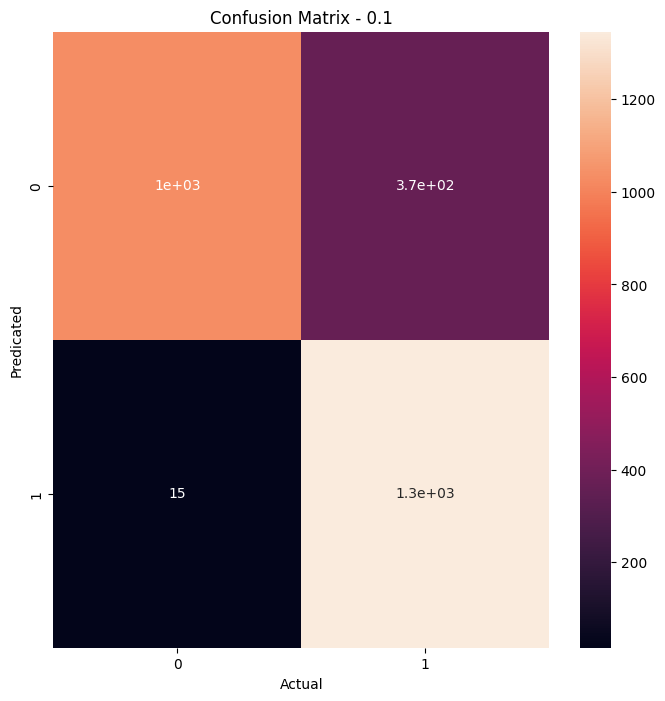

In [ ]:
plt.figure(figsize=(8,8))
sns.heatmap(cm, annot=True)
plt.title('Confusion Matrix - {}'.format(threshold))
plt.xlabel('Actual')
plt.ylabel('Predicated')

# ROC plots

from sklearn.metrics import roc_curve

In [27]:
fp, tp, threshold = roc_curve(labels, predicted)
print(len(fp), len(tp), len(threshold))

NameError: name 'roc_curve' is not defined

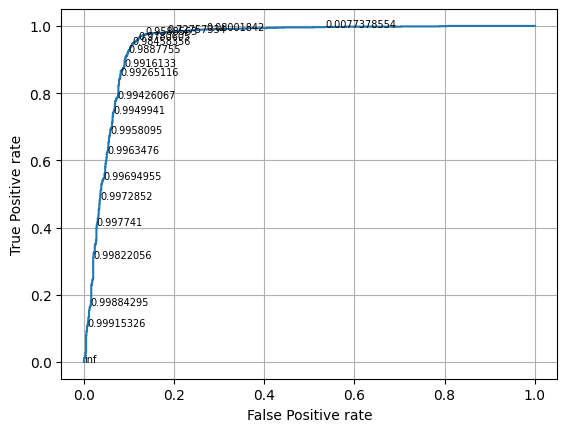

In [ ]:
plt.plot(fp,tp)
plt.xlabel("False Positive rate")
plt.ylabel("True Positive rate")
plt.grid()
skip=20
for i in range(0, len(threshold), skip):
    plt.text(fp[i], tp[i], threshold[i], fontsize=7)
plt.show()

If you want to ensure that you try to minimize as much as possible FP rate without reducting your TP rate too much, then pick value just little below the middle of the bending curve

If you want to make sure TP rate remains quite high even at the detriment of FP rate then you would tend to pick out values in just little above the middle of the bending curve 

# Tensorflow CallBacks

Callbacks are methods we call during training, evaluating our prediction. This premit us extract useful information or even carry out changes from processes.

tf.keras.callbacks.Callback() = abstract base class used to build new callbacks.

In [33]:
from tensorflow.keras.callbacks import Callback

In [28]:
class LossCallback(Callback):
    def on_epoch_end(self, epoch, logs):
        print("\n For Epoch Number {} the model has a loss of {}".format(epoch+1, logs["loss"]))
    def on_batch_end(self, batch, logs):
        print("\n For Batch Number {} the model has loss of {}". format(batch+1, logs))

In [29]:
metrics=[TruePositives(name='tp'), FalsePositives(name='fp'), TrueNegatives(name='tn'), FalseNegatives(name='fn'), BinaryAccuracy(name='accuracy'), Precision(name='precision'), Recall(name='recall'), AUC(name='auc')]

model.compile(optimizer=Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics = metrics
)

history=model.fit(train_dataset, validation_data=val_dataset, epochs=2, verbose=1, callbacks=[LossCallback()])

Epoch 1/2

 For Batch Number 1 the model has loss of {'accuracy': 0.59375, 'auc': 0.476190447807312, 'fn': 8.0, 'fp': 5.0, 'loss': 0.8660273551940918, 'precision': 0.6666666865348816, 'recall': 0.5555555820465088, 'tn': 9.0, 'tp': 10.0}
  1/689 ━━━━━━━━━━━━━━━━━━━━ 1:05:32 6s/step - accuracy: 0.5938 - auc: 0.4762 - fn: 8.0000 - fp: 5.0000 - loss: 0.8660 - precision: 0.6667 - recall: 0.5556 - tn: 9.0000 - tp: 10.0000
 For Batch Number 2 the model has loss of {'accuracy': 0.53125, 'auc': 0.45947265625, 'fn': 13.0, 'fp': 17.0, 'loss': 0.8763047456741333, 'precision': 0.5277777910232544, 'recall': 0.59375, 'tn': 15.0, 'tp': 19.0}
  2/689 ━━━━━━━━━━━━━━━━━━━━ 3:00 263ms/step - accuracy: 0.5625 - auc: 0.4678 - fn: 10.5000 - fp: 11.0000 - loss: 0.8712 - precision: 0.5972 - recall: 0.5747 - tn: 12.0000 - tp: 14.5000
 For Batch Number 3 the model has loss of {'accuracy': 0.53125, 'auc': 0.47342047095298767, 'fn': 21.0, 'fp': 24.0, 'loss': 0.8209891319274902, 'precision': 0.5555555820465088, 're

CSVLogger = callback that streams epoch results to a CSV file

In [30]:
csv_callback = tf.keras.callbacks.CSVLogger(
    'logs.csv', separator=',', append= False # append false remove old data
)

In [31]:
metrics=[TruePositives(name='tp'), FalsePositives(name='fp'), TrueNegatives(name='tn'), FalseNegatives(name='fn'), BinaryAccuracy(name='accuracy'), Precision(name='precision'), Recall(name='recall'), AUC(name='auc')]

model.compile(optimizer=Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics = metrics
)

history=model.fit(train_dataset, validation_data=val_dataset, epochs=2, verbose=1, callbacks=[csv_callback])

Epoch 1/2
689/689 ━━━━━━━━━━━━━━━━━━━━ 174s 245ms/step - accuracy: 0.9188 - auc: 0.9513 - fn: 299.5985 - fp: 597.5232 - loss: 0.2547 - precision: 0.9003 - recall: 0.9433 - tn: 4921.4434 - tp: 5237.3828 - val_accuracy: 0.8316 - val_auc: 0.9233 - val_fn: 13.0000 - val_fp: 451.0000 - val_loss: 0.8506 - val_precision: 0.7518 - val_recall: 0.9906 - val_tn: 925.0000 - val_tp: 1366.0000
Epoch 2/2
689/689 ━━━━━━━━━━━━━━━━━━━━ 172s 249ms/step - accuracy: 0.9325 - auc: 0.9642 - fn: 251.1449 - fp: 508.1319 - loss: 0.2104 - precision: 0.9141 - recall: 0.9557 - tn: 5010.7188 - tp: 5285.9521 - val_accuracy: 0.4933 - val_auc: 0.9643 - val_fn: 1395.0000 - val_fp: 1.0000 - val_loss: 0.7637 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_tn: 1359.0000 - val_tp: 0.0000e+00


Early stopping = If we see model is not improving then we stop training though epochs has not complete

In [32]:
tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', # what to look
    min_delta=0, # min change below this consider no change
    patience=0, # looking number of epoch before stopping if no improvement
    verbose=0,
    mode='auto', 
    baseline=None,
    restore_best_weights=False,
    start_from_epoch=0
)

Learning Rate Scheduling:we can modify learning rate based on current epoch and predefine function.

In [ ]:
tf.keras.callbacks.LearningRateScheduler(
    schedule, verbose=0
)

In [ ]:
def scheduler(epoch, lr):
    if epoch<3:
        return lr
    else:
        return lr+tf.math.exp(-0.1)
scheduler_callback = tf.keras.callbacks.LearningRateScheduler(schedule, verbose=1)

ModelCheckpointing: Callback to save the keras model or model weights at some frequency 

In [ ]:
tf.keras.callbacks.ModelCheckpoint(
    filepath,
    monitor='val_loss',
    verbose=0,
    save_best_only=False,
    save_weights_only=False,
    mode='auto',
    save_freq='epoch',
    initial_value_threshold=None
)

ReduceLROnPlateau: Reduce learning rate when a metric has stopped improving

In [ ]:
tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=10,
    verbose=0,
    mode='auto',
    min_delta=0.0001,
    cooldown=0,
    min_lr=0.0,
    **kwargs
)

# Mitigating overfitting and underfitting

Overfitting: 

Main cause of overfitting is having a small data set and larg and complex model which contains so many parameters.

If a model like say DNN has many parameters and you are giving it a small data set then obviously it's gonna adjust its parameters. such that on this small data set it performs exceptionally well. 

To solve these problem:

1. collect more data(Representative and Diverse):
2. Data Augmentaion
3. Dropout
4. Regularization
5. Early Stopping
6. Smaller Network
7. Hyperparameter Tuning 
8. Normalization

Underfitting: 
Our model is still too simple that wee just end up low accuracy

Our data or relative size of data as compared to the model may be too large

data is small but model is too simple

sometime we cannot extract information though the model is complex because it is not build that way

To solve these problem:
1. More model complexity
2. Collect more data(Representative and Diverse)
3. More training time
4. Hyperparameter tuning 
5. Normalization

In [ ]:
# Dropout 
tf.keras.layers.Dropout(
    rate=drop_rate, noise_shape=None, seed=None, **kwargs
)

# Data Augmentation

## Augmentation with tf.image and Keras Layers

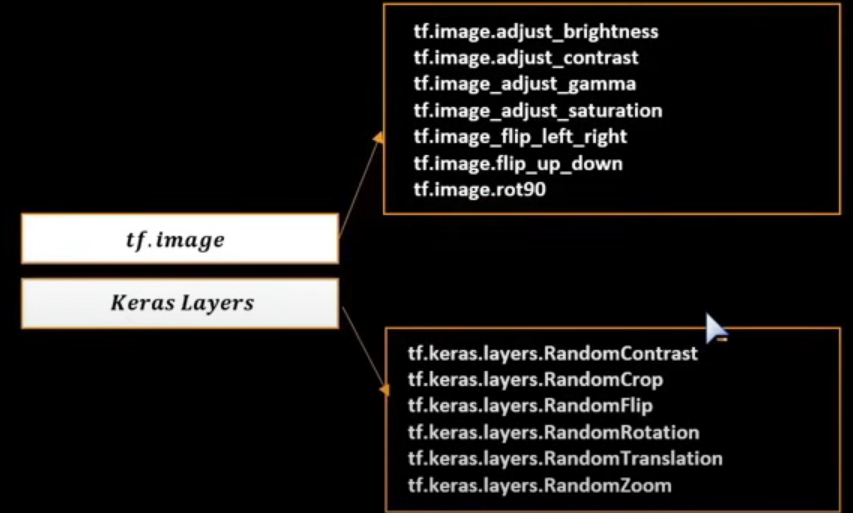

In [15]:
def visualize(original, augmented):
    plt.subplot(1,2,1)
    plt.imshow(original)
    
    plt.subplot(1,2,2)
    plt.imshow(augmented)

In [16]:
sample = next(iter(train_dataset))
print(type(sample)) 

<class 'tuple'>


In [17]:
original_image, label=next(iter(train_dataset))
original_image= original_image[0]
augmented_image = tf.image.flip_left_right(original_image)
visualize(original_image, augmented_image)

ValueError: 'image' (shape (103, 3)) must be at least three-dimensional.

In [18]:
augmented_image = tf.image.random_flip_left_right(original_image)
visualize(original_image, augmented_image)

ValueError: 'image' (shape (103, 3)) must be at least three-dimensional.

In [19]:
augmented_image = tf.image.rot90(original_image)
visualize(original_image, augmented_image)

ValueError: 'image' (shape (103, 3)) must be at least three-dimensional.

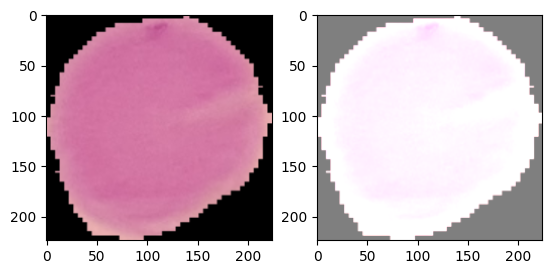

In [ ]:
augmented_image = tf.image.adjust_brightness(original_image, delta=0.5) # delta os -1 to 1
visualize(original_image, augmented_image)

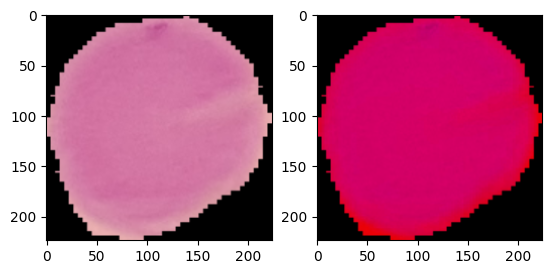

In [50]:
augmented_image = tf.image.random_saturation(original_image, lower=2, upper=12)
visualize(original_image, augmented_image)

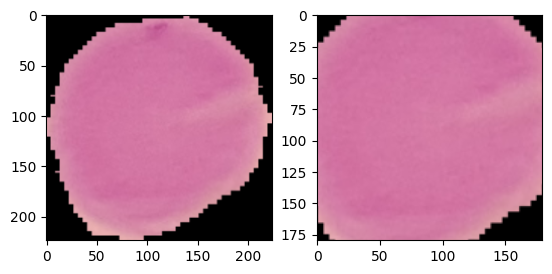

In [52]:
augmented_image = tf.image.central_crop(original_image, central_fraction=0.8) # 0 to 1
visualize(original_image, augmented_image)

In [60]:
# custom augment
def augmented(image, label):
    image, label = resizing_rescaling(image, label)
    image = tf.image.rot90(image)
    image = tf.image.adjust_saturation(image, saturation_factor=0.3)
    image = tf.image.flip_left_right(image) 
    
    return image, label

In [61]:
train_dataset = train_dataset.map(augmented)
val_dataset = val_dataset.map(resizing_rescaling)
test_dataset = test_dataset.map(resizing_rescaling)
train_dataset

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [62]:
train_dataset = train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).map(augmented).batch(32).prefetch(tf.data.AUTOTUNE)

In [63]:
val_dataset = (
    val_dataset
    .shuffle(buffer_size=8, reshuffle_each_iteration=True)
    .map(augmented)
    .batch(32)
    .prefetch(tf.data.AUTOTUNE)
)

## using keras

In [ ]:
#preprocessing layer which randomly rotates images during training
tf.keras.layers.RandomRotation(
    factor, # factor=(-0.2, 0.3) 
    fill_mode='reflect',
    interpolation='bilinear',
    seed=None,
    fill_value=0.0,
    value_range=(0, 255),
    data_format=None,
    **kwargs
)

#preprocessing layer which randomly flips images during training
tf.keras.layers.RandomFlip(
    mode=HORIZONTAL_AND_VERTICAL, seed=None, **kwargs
)

In [ ]:
# to resize and rescale layer
resize_rescale_layers = tf.keras.Sequential(
   [
       tf.keras.Resizing(244,244),
       tf.keras.Rescaling(1.0/255)
   ] 
)

In [ ]:
augment_layers=tf.keras.Sequential(
    [
        RandomRotation(factor=(0.25, 0.2501),),
        RandomFlip(mode='horizontal',),
    ]
)

def augment_layer(image, label):
    return augment_layers(resize_rescale_layers(image), training = True), label

train_dataset = train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).map(augmented_layers).batch(32).prefetch(tf.data.AUTOTUNE)

In [ ]:
model = tf.keras.Sequential([
    InputLayer(shape=(None,None,3)),
    resize_rescale_layers, # no need to change for test because it bulit in model 
    augment_layers,
    Conv2D(filters=6,kernel_size=3,strides=1,padding="valid",activation = "relu"), 
    BatchNormalization(),
    MaxPool2D(pool_size=2, strides=2),
    Conv2D(filters=16,kernel_size=3,strides=1,padding="valid",activation = "relu"), 
    BatchNormalization(),
    MaxPool2D(pool_size=2, strides=2),
    Flatten(),
    Dense(100, activation= 'relu'),
    BatchNormalization(),
    Dense(10, activation= 'relu'),
    BatchNormalization(),
    Dense(1, activation= 'sigmoid'),
])
model.summary()

In [ ]:
import cv2
image= cv2.imread('image.jpg')
image= tf.expand_dims(image, axis=0) # it add 1 dims at axis 0
# we are doing expand_dims since we have train in batch size=1

#now predict
model.predict(image)

In tf.keras, when you want pre-processing that is resizing, rescaling and augmentation to be in form of layers. We get speed and portability of keras layers

In tf.image, it more flexiable to work with

In [ ]:
# we use .image in .keras . We get sped and portability of keras ans flexiablity of image
from tensorflow.keras.layers import Layer
class RotNinety(Layer):
    def __init__(self):
        super().__init__()
    def call(self, image):
        return tf.image.rot90(image)

augment_layers=tf.keras.Sequential(
    [
        RotNinety(),
        tf.keras.layers.RandomFlip(mode='horizontal',),
    ]
)

def augment_layer(image, label):
    return augment_layers(resize_rescale_layers(image), training = True), label

# Mixup Augmentation

We use one image over another image

We have orginal sample X1 and X2 of label y1 and y2 respectively. We need to create new data using these two data then

X' = lambda X1 + (1-lambda) X2
Y' = lambda Y1 + (1-lambda) Y2

value of lambda E [0,1]

In [27]:
!pip install --user --upgrade tensorflow tensorflow-probability



  Using cached tensorflow-2.19.0-cp310-cp310-win_amd64.whl.metadata (4.1 kB)
Using cached tensorflow-2.19.0-cp310-cp310-win_amd64.whl (375.7 MB)


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


In [20]:
import tensorflow_probability as tfp


In the Beta distribution, the two parameters α (alpha) and β (beta) control the shape of the distribution.

- Alpha (α): Controls how much the distribution leans toward 1.
If α > β, the distribution is skewed right (favoring higher values, closer to 1).
- Beta (β): Controls how much the distribution leans toward 0.
If β > α, the distribution is skewed left (favoring lower values, closer to 0).

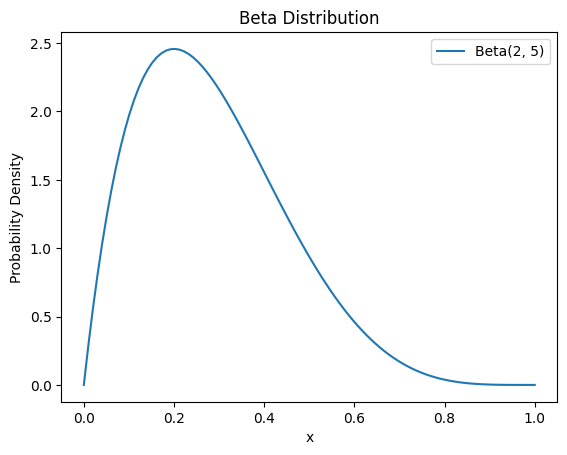

In [21]:
import numpy as np
import matplotlib.pyplot as plt

x = np.linspace(0, 1, 100)
alpha, beta = 2, 5  # Adjust these values
beta_dist = tfp.distributions.Beta(concentration1=alpha, concentration0=beta)

plt.plot(x, beta_dist.prob(x), label=f'Beta({alpha}, {beta})')
plt.xlabel('x')
plt.ylabel('Probability Density')
plt.legend()
plt.title("Beta Distribution")
plt.show()

In [12]:
tfp.distributions.Beta(
    concentration1=0.4,
    concentration0=0.4,
    validate_args=False,
    allow_nan_stats=True,
    force_probs_to_zero_outside_support=False,
    name='Beta'
)

<tfp.distributions.Beta 'Beta' batch_shape=[] event_shape=[] dtype=float32>

(256, 256, 3) tf.Tensor(0.9723662, shape=(), dtype=float32)


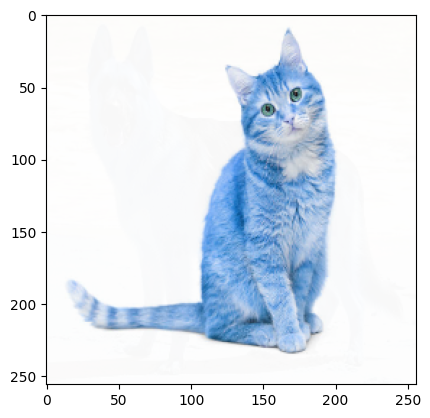

In [22]:
import cv2
image_1= cv2.resize(cv2.imread('im1.jpeg'), (256,256))
image_2=cv2.resize(cv2.imread('im1.jpg'),(256,256))
lambd= tfp.distributions.Beta(0.2,0.2)
label_1=0
label_2=1

lambd=lambd.sample(1)[0]
image = lambd*image_1 + (1-lambd)*image_2
label = lambd*label_1 + (1-lambd)*label_2
print(image.shape, label)
plt.imshow(image/255)

In [23]:
train_dataset_1=train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).map(resizing_rescaling)
train_dataset_2=train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).map(resizing_rescaling)
mixed_dataset=tf.data.Dataset.zip((train_dataset_1, train_dataset_2)) #combines multiple iterables (like lists or tuples) element-wise into tuples.


In [24]:
def mixup(train_dataset_1, train_dataset_2):
    (image_1, label_1), (image_2, label_2)=train_dataset_1,train_dataset_2
    lambd= tfp.distributions.Beta(0.4,0.4)
    lambd=lambd.sample(1)[0]
    image = lambd*image_1 + (1-lambd)*image_2
    label = lambd*tf.cast(label_1, dtype=tf.float32) + (1-lambd)*tf.cast(label_2, dtype=tf.float32)
    return image, label

In [29]:
train_dataset = (
    mixed_dataset
    .shuffle(buffer_size=8, reshuffle_each_iteration=True)
    .map(mixup)
    .batch(32)
    .prefetch(tf.data.AUTOTUNE)
)

In [30]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.float32, name=None))>

In [31]:
mixed_dataset

<_ZipDataset element_spec=((TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None)), (TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None)))>

# Cut-Mix Augmentation

we cut and place some pixel of one image to another image and replace it.

In [42]:
import cv2

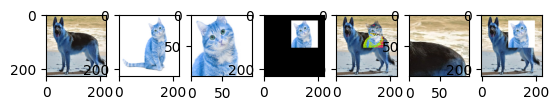

In [43]:
plt.subplot(1,7,1)
image_1=cv2.resize(cv2.imread('im1.jpeg'), (224,224))
plt.imshow(image_1)

plt.subplot(1,7,2)
image_2= cv2.resize(cv2.imread('im1.jpg'), (224,224))
plt.imshow(image_2)

plt.subplot(1,7,3)
crop= tf.image.crop_to_bounding_box(image_2, 20, 100, 100, 98)
plt.imshow(crop)

plt.subplot(1,7,4)
image_3=tf.image.pad_to_bounding_box(crop,20, 100, 224,224)
plt.imshow(image_3)

plt.subplot(1,7,5)
image_4 = tf.image.pad_to_bounding_box(crop, 20, 100, 224, 224)
plt.imshow(image_4+image_1)

plt.subplot(1,7,6)
crop_image1= tf.image.crop_to_bounding_box(image_1, 20, 100, 100, 98)
plt.imshow(crop_image1)

plt.subplot(1,7,7)
image_5= tf.image.pad_to_bounding_box(crop_image1, 20, 100, 224,224)
plt.imshow(image_1-image_5+image_4)



In [ ]:
def mixup(train_dataset_1, train_dataset_2):
    (image_1, label_1), (image_2, label_2)=train_dataset_1,train_dataset_2
    crop_2= tf.image.crop_to_bounding_box(image_2, 20, 100, 100, 98)
    pad_2 = tf.image.pad_to_bounding_box(crop_2, 20, 100, 224, 224)
    
    crop_1= tf.image.crop_to_bounding_box(image_1, 20, 100, 100, 98)
    pad_1= tf.image.pad_to_bounding_box(crop_1, 20, 100, 224,224)
    image= image_1-pad_1+pad_2
    
    return image, label


**Step 1: Select Two Images**
We take **two random training images** and their labels:

- **Image A**: (x_A, y_A)  
- **Image B**: (x_B, y_B)

These images will be combined to create a new training sample.

**Step 2: Generate a Random Cutout Region**
We randomly decide where and how much of **Image A** should be replaced with a patch from **Image B**.

1. **Randomly choose a position** (r_x, r_y) where the cutout box starts.
   - r_x ~ U(0, W) → random x-coordinate in the image width  
   - r_y ~ U(0, H) → random y-coordinate in the image height  

2. **Determine the size of the cutout box**:
   - Calculate width: r_w = W sqrt{1 - \lambda}  
   - Calculate height: r_h = H sqrt{1 - \lambda}

   Here, (lambda) is sampled from a **Beta distribution** Beta(alpha, alpha), which controls how much of Image A is retained.

3. **Compute the area ratio** of the patch taken from Image B:
   
   {r_w r_h}/{W H} = 1 - lambda

   This means (lambda) determines how much of Image A is kept, while (1 - lambda) represents the proportion replaced by Image B.

**Step 3: Apply the CutMix Mask**
1. **Create a binary mask M**:
   - M is a **same-sized matrix as the image**.
   - **Inside the cutout region:** M = 0 → Replace with Image B.  
   - **Outside the cutout region:** M = 1 → Keep Image A.

2. **Blend the two images** using element-wise multiplication '.':
   tilde{x} = M . x_A + (1 - M) . x_B
   
   - The cutout region from **Image A** is replaced by the corresponding region from **Image B**.

**Step 4: Adjust the Labels**
Since the new image contains parts of both Image A and Image B, we adjust the labels accordingly:

tilde{y} = lambda y_A + (1 - lambda) y_B


- The contribution of **Label A** is **proportional to the retained area** (lambda).
- The contribution of **Label B** is **proportional to the replaced area** (1 - lambda).

For example, if **40% of the image is replaced**, then:
- (lambda = 0.6) → **60% weight to (y_A)**  
- (1 - lambda = 0.4) → **40% weight to (y_B)**

**Step 5: Use the New Image for Training**
- The modified image tilde{x} and label tilde{y} are used as training data.
- The model learns from mixed images, improving **robustness and generalization**.


In [ ]:
tfp.distributions.Uniform(
    low=0.0,
    high=1.0,
    validate_args=False,
    allow_nan_stats=True,
    name='Uniform'
)

In [25]:
def box(lamda):
    #This is the center of the box.
    r_x = tf.cast(tfp.distributions.Uniform(0, IM_SIZE).sample(1)[0], dtype = tf.int32)
    r_y = tf.cast(tfp.distributions.Uniform(0, IM_SIZE).sample(1)[0], dtype = tf.int32)
    #Calculate width (r_w) and height (r_h) of the box.#
    r_w = tf.cast(IM_SIZE*tf.math.sqrt(1-lamda), dtype = tf.int32)
    r_h = tf.cast(IM_SIZE*tf.math.sqrt(1-lamda), dtype = tf.int32)
    #Clip the values so box doesn’t go outside the image
    #Top-Left Corner
    r_x = tf.clip_by_value(r_x - r_w//2, 0, IM_SIZE)
    r_y = tf.clip_by_value(r_y - r_h//2, 0, IM_SIZE)
    #Get bottom-right corner
    x_b_r = tf.clip_by_value(r_x + r_w//2, 0, IM_SIZE)
    y_b_r = tf.clip_by_value(r_y + r_h//2, 0, IM_SIZE)
    #Compute actual width & height.
    #If width or height is zero, set to 1 pixel minimum (avoid errors).
    r_w = x_b_r - r_x
    if(r_w == 0):
        r_w  = 1

    r_h = y_b_r - r_y
    if(r_h == 0):
        r_h = 1

    return r_y, r_x, r_h, r_w

In [26]:
def cutmix(train_dataset_1, train_dataset_2):
    (image_1,label_1), (image_2, label_2) = train_dataset_1, train_dataset_2

    lamda = tfp.distributions.Beta(0.2,0.2)
    lamda = lamda.sample(1)[0]

    r_y, r_x, r_h, r_w = box(lamda)
    crop_2 = tf.image.crop_to_bounding_box(image_2, r_y, r_x, r_h, r_w)
    pad_2 = tf.image.pad_to_bounding_box(crop_2, r_y, r_x, IM_SIZE, IM_SIZE)

    crop_1 = tf.image.crop_to_bounding_box(image_1, r_y, r_x, r_h, r_w)
    pad_1 = tf.image.pad_to_bounding_box(crop_1, r_y, r_x, IM_SIZE, IM_SIZE)

    image = image_1 - pad_1 + pad_2

    lamda = tf.cast(1- (r_w*r_h)/(IM_SIZE*IM_SIZE), dtype = tf.float32)
    label = lamda*tf.cast(label_1, dtype = tf.float32) + (1-lamda)*tf.cast(label_2, dtype = tf.float32)

    return image, label

In [58]:
train_dataset = (
    mixed_dataset
    .shuffle(buffer_size=8, reshuffle_each_iteration=True)
    .map(cutmix)
    .batch(32)
    .prefetch(tf.data.AUTOTUNE)
)

tf.Tensor(
[[1.85166866e-01 1.00000000e+00 1.00000000e+00 ... 7.67538249e-01
  2.32039362e-01 0.00000000e+00]
 [6.55225396e-01 7.54429340e-01 4.30813700e-01 ... 7.41799116e-01
  8.14741910e-01 6.02975711e-02]
 [1.00000000e+00 9.99940932e-01 7.54444361e-01 ... 9.87271011e-01
  8.14741910e-01 2.45555639e-01]
 ...
 [3.72777820e-01 8.11374009e-01 1.84166729e-01 ... 1.34900138e-01
  2.50000000e-01 9.99994993e-01]
 [9.99998868e-01 2.47860923e-01 2.89240063e-07 ... 9.97275531e-01
  9.89038765e-01 3.52327270e-03]
 [2.45550752e-01 1.00000000e+00 1.24379724e-01 ... 1.00000000e+00
  2.41146356e-01 9.66498554e-01]], shape=(32, 32), dtype=float32)


TypeError: Invalid shape (32, 224, 224, 3) for image data

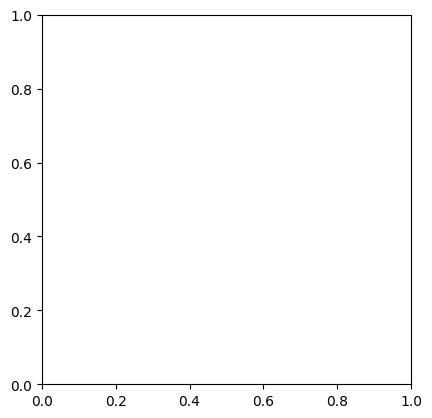

In [67]:
import matplotlib.pyplot as plt


original_image, label = next(iter(train_dataset))
print(label)
plt.imshow(original_image[[0]])

# Albumentation

computer vision tool that boosts the performance of deep convolutional neural networks.

In [1]:
!pip install -U albumentations

   ---------------------------------------- 0.0/2.0 MB ? eta -:--:--
   ---------------------------------------- 2.0/2.0 MB 18.3 MB/s eta 0:00:00
  Attempting uninstall: pydantic
    Found existing installation: pydantic 1.10.2
    Uninstalling pydantic-1.10.2:
      Successfully uninstalled pydantic-1.10.2


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
fastapi 0.87.0 requires pydantic!=1.7,!=1.7.1,!=1.7.2,!=1.7.3,!=1.8,!=1.8.1,<2.0.0,>=1.6.2, but you have pydantic 2.10.6 which is incompatible.


In [7]:
import albumentations as A

In [ ]:
transforms = A.Compose(
    [
        A.Resize(IM_SIZE, IM_SIZE),

        A.OneOf([A.HorizontalFlip(),
                A.VerticalFlip(),], p = 0.3), # ether of them will be selected
        
        A.RandomRotate90(),   
        #A.RandomGridShuffle(grid=(3, 3), always_apply=False, p=0.5),
        A.RandomBrightnessContrast(brightness_limit=0.2,
                                contrast_limit=0.2,
                                always_apply=False, p=0.5),
        #A.Cutout(num_holes=8, max_h_size=8, max_w_size=8, fill_value=0, always_apply=False, p=0.5),
        A.Sharpen(alpha=(0.2, 0.5), lightness=(0.5, 1.0), always_apply=False, p=0.5),
])

C:\Users\avith\AppData\Local\Temp\ipykernel_15068\3094060279.py:10: UserWarning: Argument(s) 'always_apply' are not valid for transform RandomBrightnessContrast
  A.RandomBrightnessContrast(brightness_limit=0.2,
C:\Users\avith\AppData\Local\Temp\ipykernel_15068\3094060279.py:14: UserWarning: Argument(s) 'always_apply' are not valid for transform Sharpen
  A.Sharpen(alpha=(0.2, 0.5), lightness=(0.5, 1.0), always_apply=False, p=0.5),


In [11]:
def aug_albument(image):
    data = {"image":image}
    image = transforms(**data)
    image = image["image"]
    image = tf.cast(image/255., tf.float32)
    return image

In [13]:
def process_data(image, label):
    aug_img = tf.numpy_function(func=aug_albument, inp=[image], Tout=tf.float32)
    return aug_img, label

In [14]:
train_dataset = (
    train_dataset
    .shuffle(buffer_size = 1024, reshuffle_each_iteration = True)
    .map(process_data)
    .batch(32)
    .prefetch(tf.data.AUTOTUNE)
)

In [15]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

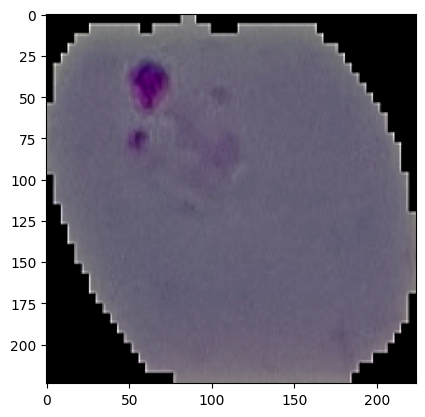

In [16]:
im, _ = next(iter(train_dataset))
plt.imshow(im[0])

# Custom Loss and Metrics

In [ ]:
factor =1
def custom_bce(factor):
    def loss(y_true, y_pred):
        bce= BinaryCrossentropy()
        return bce(y_true, y_pred)* factor
    return loss

In [ ]:
model.compile(optimizer = Adam(learning_rate=0.01),
             loss=custom_bce(factor),
             metrics= metrics,
             )

In [ ]:
factor=1
# class inherit from keras loss class
class CustomBCE(tf.keras.losses.Loss):
    def __init__(self, factor):
        super(CustomBCE, self).__init__()
        self.factor = factor
    def call(self, y_true, y_pred):
        bce=BinaryCrossentropy()
        return bce(y_true, y_pred)* self.factor
        
model.compile(optimizer = Adam(learning_rate=0.01),
             loss=CustomBCE(factor),
             metrics= metrics,
             )
        
    

In [ ]:
# custom metrics function
#tf.keras.metrics.binary_accuracy()
from tensorflow.keras.metics import binary_accuracy

def custom_accuracy(factor):
    def metric(y_true,y_pred):
        return binary_accuracy(y_true, y_pred)
    return metric

model.compile(optimizer = Adam(learning_rate=0.01),
             loss=CustomBCE(factor),
             metrics= custom_accuracy(factor),
             )

In [ ]:
factor=1
# class inherit from keras metric class
class CustomAccuracy(tf.keras.metrics.Metric):
    def __init__(self, name= 'Custom_Accuracy', factor):
        super(CustomAccuracy, self).__init__()
        self.factor = factor
        self.accuracy = self.add_weight(name= name, initial ='zeros')
        
    def update_state(self, y_true, y_pred, sample_weight = None): # update the metrics state
        output = binary_accuracy(tf.cast(y_true, dtype=tf.float32), y_pred)*self.factor
        self.accuracy.assign(tf.math_count_nonzero(output, dtype=tf.float32)/tf.cast(len(output), dtype=tf.float32))
    
    def result(self): # give output of metrics
        return self.accuracy 
    
    def reset_states(self): # reset the metrics state at the end of each epoch
        self.accuracy.assign(0.)
    
        
model.compile(optimizer = Adam(learning_rate=0.01),
             loss=CustomBCE(factor),
             metrics= CustomAccuracy(factor),
             )

# Eagar and Graph modes


Eager mode= Every step runs NOW, you can see output immediately.

Graph mode= TensorFlow builds a full plan first, then executes it all at once.
In graph mode, we have data which is passed into these different nodes right here.
to make graph mode, we need to use decorater @tf.function. It does calll tracing. During this process, graph is generated
Ad: 
- portable
- parallel processing possible

If we put decorator in big function then no need for small function decorator 

In [2]:
import tensorflow as tf
@tf.function  # Converts function to graph
def add(x):
    return x + 2

add(tf.constant(3))  # Runs as graph


<tf.Tensor: shape=(), dtype=int32, numpy=5>

In [3]:
x = tf.constant(3)
y = x + 2  # Runs immediately
print(y)   # Outputs the result now


tf.Tensor(5, shape=(), dtype=int32)


In [ ]:
IM_SIZE=224
@tf.function
def resize_rescale(image, label):
    return tf.image.resize(image, (IM_SIZE,IM_SIZE))/255.0, label

In [ ]:
resize_rescale_layers= tf.keras.Sequentail([
    Resizing(IM_SIZE,IM_SIZE),
    Rescaling(1./255)
    
])

In [ ]:
# custom augment
@tf.function
def augmented(image, label):
    image, label = resize_rescale(image, label)
    image = tf.image.rot90(image)
    #image = tf.image.adjust_saturation(image, saturation_factor=0.3)
    image = tf.image.flip_left_right(image) 
    
    return image, label

In [ ]:
original_image, label = next(iter(train_dataset))
@tf.function
def resize_rescale(image, label):
  print("I was here")
  tf.print("I was here")
  return tf.image.resize(image, (IM_SIZE, IM_SIZE))/255.0, label

_, _ = resize_rescale(original_image, label)
_, _ = resize_rescale(original_image, label)


OUTPUT WILL BE:
I was here      # Python print (only first call)
I was here      # tf.print (first call)
I was here      # tf.print (second call)


**Why `print()` runs ONCE:**

**Reason:**
- **`@tf.function` converts Python code to a static graph.**
- During **first call**, TensorFlow **"traces"** (records) the function.
- **Python’s `print()` runs while tracing, like normal Python code.**
- After graph is built → Python code is **ignored!**

✅ **First call:** `print()` runs.  
❌ **Next calls:** Python code doesn’t run again, graph already exists!


**Why `tf.print()` runs EVERY TIME:**

**Reason:**
- **`tf.print()` becomes part of the computation graph.**
- TensorFlow treats it like any operation (like math ops).
- **Every time the graph runs, TensorFlow executes `tf.print()`.**

**Quick Analogy:**

| **print()**         | **tf.print()**                     |
|--------------------|------------------------------------|
| Python-level        | TensorFlow operation (graph part)  |
| Runs only during tracing | Runs every time graph runs     |


# Custom Training Loops

In [ ]:

OPTIMIZER = Adam(learning_rate = 0.01)
METRIC = BinaryAccuracy()
METRIC_VAL = BinaryAccuracy()
EPOCHS = CONFIGURATION['N_EPOCHS']
     

CURRENT_TIME = datetime.datetime.now().strftime('%d%m%y - %h%m%s')
CUSTOM_TRAIN_DIR = './logs/' + CURRENT_TIME + '/custom/train'
CUSTOM_VAL_DIR = './logs/' + CURRENT_TIME + '/custom/val'

custom_train_writer = tf.summary.create_file_writer(CUSTOM_TRAIN_DIR)
custom_val_writer = tf.summary.create_file_writer(CUSTOM_VAL_DIR)

In [ ]:
@tf.function
def training_block(x_batch, y_batch):
    with tf.GradientTape() as recorder:
        y_pred = model(x_batch, training = True)
        loss = custom_bce(y_batch, y_pred)

    #wandb.log({'loss':loss.numpy()})
    partial_derivatives = recorder.gradient(loss, model.trainable_weights)
    OPTIMIZER.apply_gradients(zip(partial_derivatives,model.trainable_weights))
    METRIC.update_state(y_batch, y_pred)
    return loss

@tf.function
def val_block(x_batch_val, y_batch_val):
    y_pred_val = model(x_batch_val, training = False)
    loss_val = custom_bce(y_batch_val, y_pred_val)
    METRIC_VAL.update_state(y_batch_val, y_pred_val)
    return loss_val


def custom_training(model, loss_function, METRIC, VAL_METRIC, OPTIMIZER, train_dataset, val_dataset, EPOCHS):
    for epoch in range(EPOCHS):
        print("Training starts for epoch number {}".format(epoch+1))
        for step, (x_batch, y_batch) in enumerate(train_dataset):
            loss = training_block(x_batch, y_batch)
      
        print("Training Loss", loss)
        print("The accuracy is: ", METRIC.result())

        with custom_train_writer.as_default():
            tf.summary.scalar('Training Loss', data = loss, step = epoch)
        with custom_train_writer.as_default():
            tf.summary.scalar('Training Accuracy', data = METRIC.result(), step = epoch)
      
        METRIC.reset_states()

        for (x_batch_val, y_batch_val) in val_dataset:
            loss_val = val_block(x_batch_val, y_batch_val)

        print("The Validation loss", loss_val)
        print("The Validation accuracy is: ", METRIC_VAL.result())

        with custom_val_writer.as_default():
            tf.summary.scalar('Validation Loss', data = loss_val, step = epoch)
        with custom_val_writer.as_default():
            tf.summary.scalar('Validation Accuracy', data = METRIC_VAL.result(), step = epoch)
      
        METRIC_VAL.reset_states()
    print("Training Complete!!!!")



custom_training(model, custom_bce, METRIC, METRIC_VAL, OPTIMIZER, train_dataset, val_dataset, EPOCHS)


# Data Logging

## Tensorboard

callbacks = permite us to modify certain key information during the training process and also store certain information and do certain modification during the training

TensorBoard callback = automatically log training/validation metrics, visualizations, and other information during model training, making it easy to monitor the process.

In [ ]:
tf.keras.callbacks.TensorBoard(
    log_dir='logs',
    histogram_freq=0,
    write_graph=True,
    write_images=False,
    write_steps_per_second=False,
    update_freq='epoch',
    profile_batch=0,
    embeddings_freq=0,
    embeddings_metadata=None
)

In [ ]:
import datetime

In [ ]:

CURRENT_TIME = datetime.datetime.now().strftime('%d%m%y - %h%m%s')
#save the train 
METRIC_DIR ='./logs/metrics'
train_writer=tf.summary.create_file_writer(METRIC_DIR)

LOG_DIR = './logs/'+ CURRENT_TIME
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=LOG_DIR, histogram_freq = 1, profile_batch = '100,132')


history=model.fit(train_dataset, validation_data=val_dataset, epochs=5, verbose=1, callbacks=[tensorboard_callback, scheduler_callback])

In [ ]:
%load_ext tensorboard

In [ ]:
#visuallization
LOG_DIR='/logs' # location of log save
tensorboard --logdir = LOG_DIR

In [ ]:
def scheduler(epoch, lr):
    if epoch<=1:
        learning_rate= lr
    else:
        learning_rate= lr*tf.math.exp(-0.1)
        learning_rate= learning_rate.numpy()
    with train_writer.as_default():
        tf.summary.scalar('Learning Rate', data=learning_rate, step=epoch)
    return learning_rate
    
scheduler_callback = LearningRateScheduler(scheduler, verbose=1)

## Image confusion matrix

In [ ]:
class LogImagesCallBack(Callback):
    def on_epoch_end(self, epoch, logs):
        labels=[]
        inp=[]
        
        for x,y in test_dataset.as_numpy_iterator():
            labels.append(y)
            inp.append(x)
        labels = np.array([i[0] for i in labels])
        predicted = model.predict(np.array(inp)[:,0,...])
        
        threshold = 0.5
        cm = confusion_matrix(labels, predicted > threshold)
        print(cm)
        plt.figure(figsize=(8,8))

        sns.heatmap(cm, annot=True,)
        plt.title('Confusion matrix - {}'.format(threshold))
        plt.ylabel('Actual')
        plt.xlabel('Predicted')
        
        #save each epoch image of cm
        buffer = io.BytesIO()
        plt.savefig(buffer, format='png')
        
        
        #decode image
        image=tf.image.decode_png(buffer.getvalue(), channels=3)
        IMAGE_DIR='./logs/'+CURRENT_TIME+'.images'
        image_writer=tf.summary.create_file_writer(IMAGE_DIR)
        
        with image_writer.as_default():
            tf.summary.image("Training Data", image, step=epoch)
        

# Hyperparameter Tuning

In [ ]:
from tensorboard.plugins.hparams import api as hp

In [ ]:
IM_SIZE = 224
def model_tune(hparams):
  lenet_model = tf.keras.Sequential([
    InputLayer(input_shape = (IM_SIZE, IM_SIZE, 3)),

    Conv2D(filters = 6, kernel_size = 3, strides=1, padding='valid',
          activation = 'relu',kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),
    MaxPool2D (pool_size = 2, strides= 2),
    Dropout(rate = hparams[HP_DROPOUT]),

    Conv2D(filters = 16, kernel_size = 3, strides=1, padding='valid',
          activation = 'relu', kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),
    MaxPool2D (pool_size = 2, strides= 2),

    Flatten(),
    
    Dense( hparams[HP_NUM_UNITS_1], activation = "relu", kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),
    Dropout(rate = hparams[HP_DROPOUT]),
    
    Dense(hparams[HP_NUM_UNITS_2], activation = "relu", kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),

    Dense(1, activation = "sigmoid"),
  ])

  model.compile(
        optimizer= Adam(learning_rate = hparams[HP_LEARNING_RATE]),
        loss='binary_crossentropy',
        metrics=['accuracy'],
    )

  model.fit(val_dataset, epochs=1)
  _, accuracy = model.evaluate(val_dataset)
  return accuracy

In [ ]:
HP_NUM_UNITS_1 = hp.HParam('num_units_1', hp.Discrete([16,32,64,128]))
HP_NUM_UNITS_2 = hp.HParam('num_units_2', hp.Discrete([16,32,64,128]))
HP_DROPOUT = hp.HParam('dropout_rate', hp.Discrete([0.1,0.2,0.3]))
HP_REGULARIZATION_RATE = hp.HParam('regularization_rate', hp.Discrete([0.001,0.01,0.1]))
HP_LEARNING_RATE = hp.HParam('learning_rate', hp.Discrete([1e-4, 1e-3]))

In [ ]:
#GridSearchCV
run_number = 0
for num_units_1 in HP_NUM_UNITS_1.domain.values:
  for num_units_2 in HP_NUM_UNITS_2.domain.values:
    for dropout_rate in HP_DROPOUT.domain.values:
      for regularization_rate in HP_REGULARIZATION_RATE.domain.values:
        for learning_rate in HP_LEARNING_RATE.domain.values:

          hparams = {
              HP_NUM_UNITS_1: num_units_1,
              HP_NUM_UNITS_2: num_units_2,
              HP_DROPOUT: dropout_rate,
              HP_REGULARIZATION_RATE: regularization_rate,
              HP_LEARNING_RATE: learning_rate,
              
          }
          file_writer = tf.summary.create_file_writer('logs/hparams-' + str(run_number))

          with file_writer.as_default():
              hp.hparams(hparams)
              accuracy = model_tune(hparams)
              tf.summary.scalar('accuracy', accuracy, step = 0)
          print("For the run {}, hparams num_units_1:{}, num_units_2:{}, dropout:{}, regularization_rate:{}, learning_rate:{}".format(run_number, hparams[HP_NUM_UNITS_1], hparams[HP_NUM_UNITS_2],
                                                             hparams[HP_DROPOUT], hparams[HP_REGULARIZATION_RATE],
                                                             hparams[HP_LEARNING_RATE]))
          run_number += 1

# Profiling and Visualizations

TensorFlow Profiler:- helps analyze and optimize TensorFlow model performance. It visualizes execution timelines, identifies inefficient operations, and guides improvements for faster training and inference.

In [1]:
pip install -U tensorboard_plugin_profile

   ---------------------------------------- 0.0/17.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/17.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/17.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/17.8 MB ? eta -:--:--
    --------------------------------------- 0.3/17.8 MB ? eta -:--:--
    --------------------------------------- 0.3/17.8 MB ? eta -:--:--
   - -------------------------------------- 0.5/17.8 MB 699.0 kB/s eta 0:00:25
   -- ------------------------------------- 1.0/17.8 MB 1.1 MB/s eta 0:00:15
   --- ------------------------------------ 1.6/17.8 MB 1.5 MB/s eta 0:00:11
   ----- ---------------------------------- 2.6/17.8 MB 2.2 MB/s eta 0:00:07
   ---------- ----------------------------- 4.7/17.8 MB 3.5 MB/s eta 0:00:04
   -------------------- ------------------- 8.9/17.8 MB 5.7 MB/s eta 0:00:02
   ----------------------- ---------------- 10.5/17.8 MB 6.4 MB/s eta 0:00:02
   ----------------------------- -----

In [ ]:
tensorboard --logdir=logs